In [3]:
import numpy as np
import pandas as pd
import cv2, glob, os
import matplotlib.pyplot as plt
%matplotlib inline

In [43]:
level = 1
model = '256_64_0_6_6_4_0.0001_20'
modelPath = "fitted/{0}/{1}/".format(level,model) 
df = pd.read_csv(modelPath+"fitted.csv")
df.head()

,path,x1,y1,x2,y2
0,6.9172045790385e-310,1.482197e-323,1.482197e-323,3.162020e-322,3.162020e-322
1,/home/msmith/kaggle/whale/locator3/cropped/tru...,4.403518e-01,3.622032e-01,5.587445e-01,6.387123e-01
2,/home/msmith/kaggle/whale/locator3/cropped/tru...,3.608437e-01,5.644040e-01,6.397240e-01,4.340733e-01
3,/home/msmith/kaggle/whale/locator3/cropped/tru...,3.967732e-01,6.432276e-01,6.075093e-01,3.614172e-01
4,/home/msmith/kaggle/whale/locator3/cropped/tru...,6.005736e-01,5.024899e-01,3.984777e-01,4.982974e-01


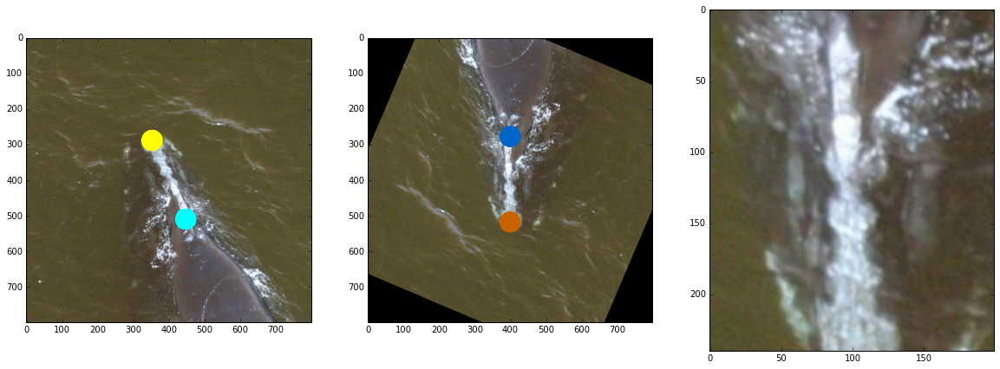

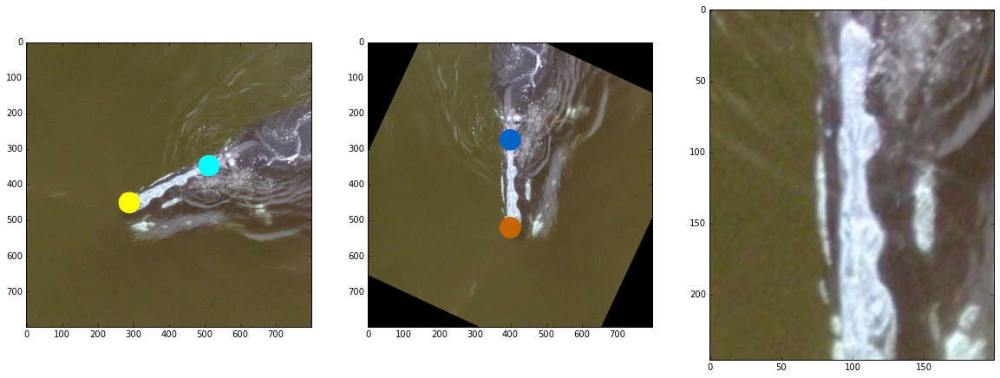

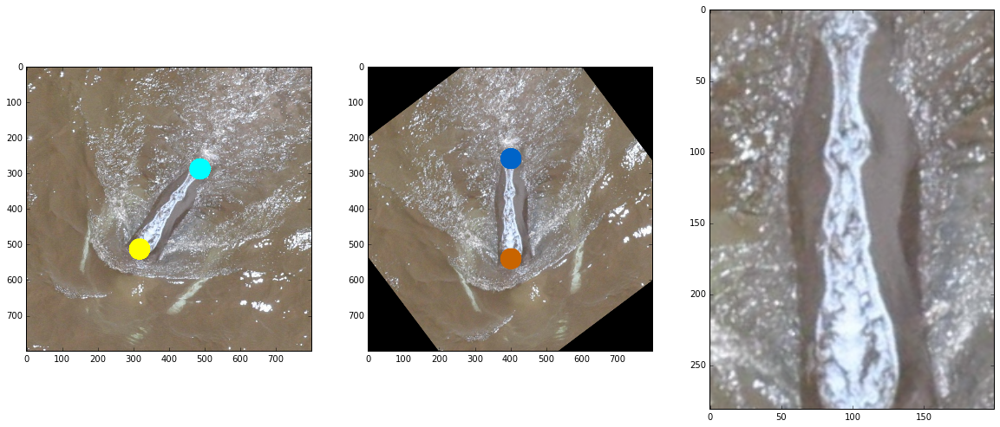

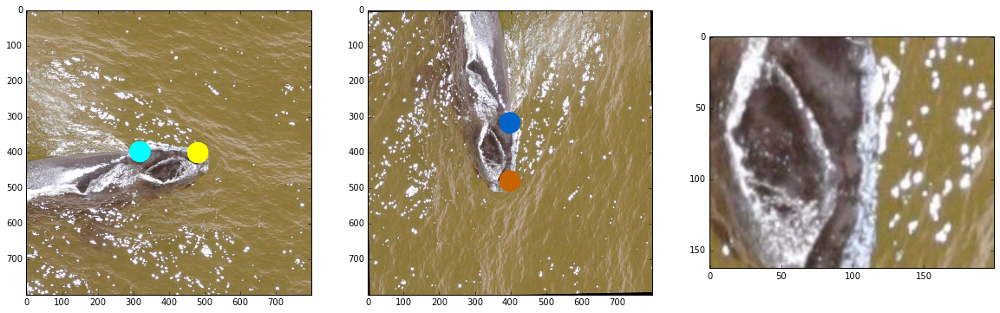

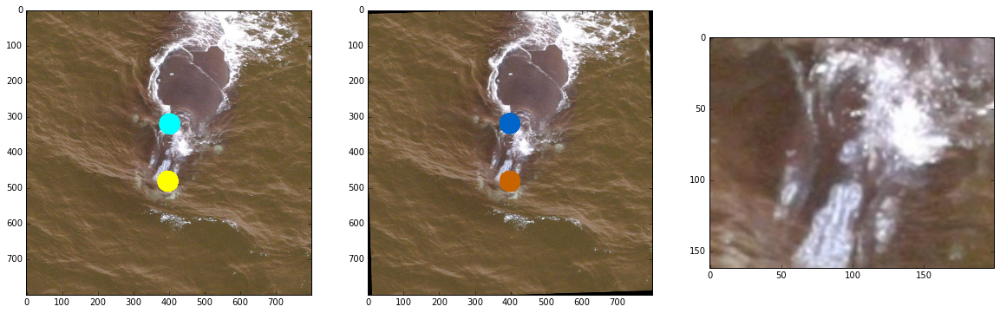

...

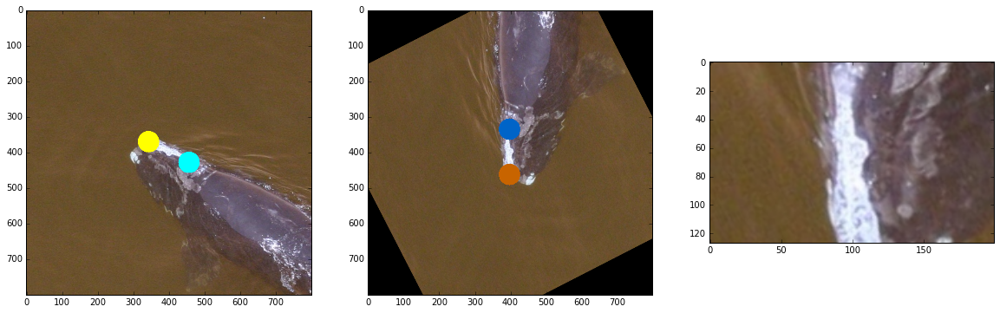

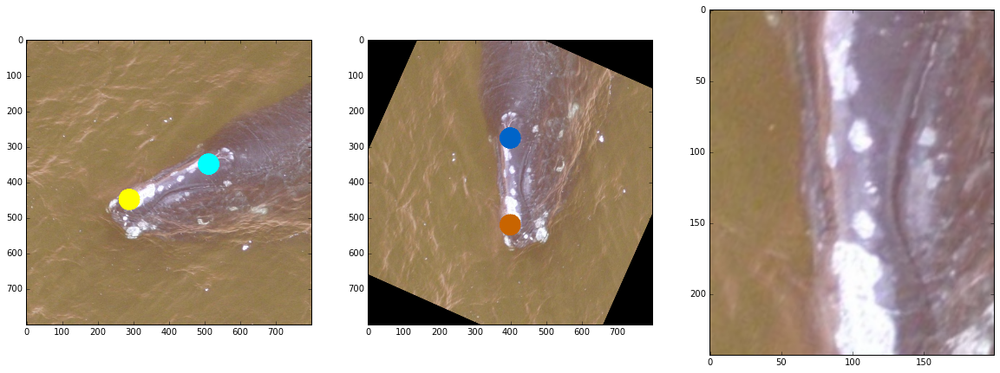

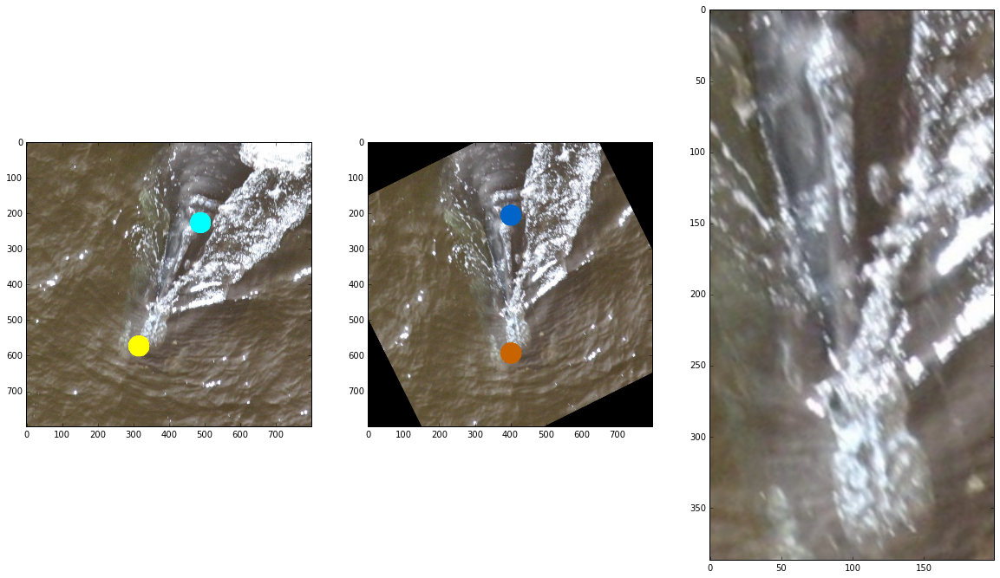

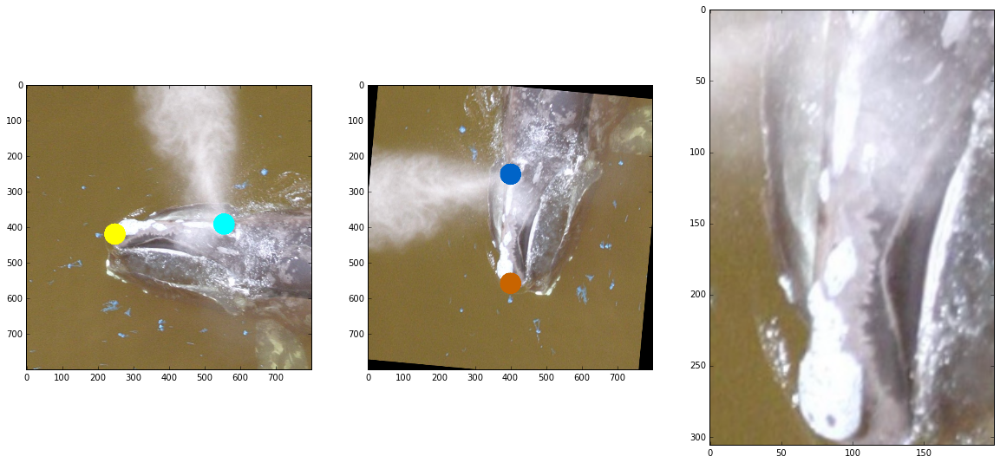

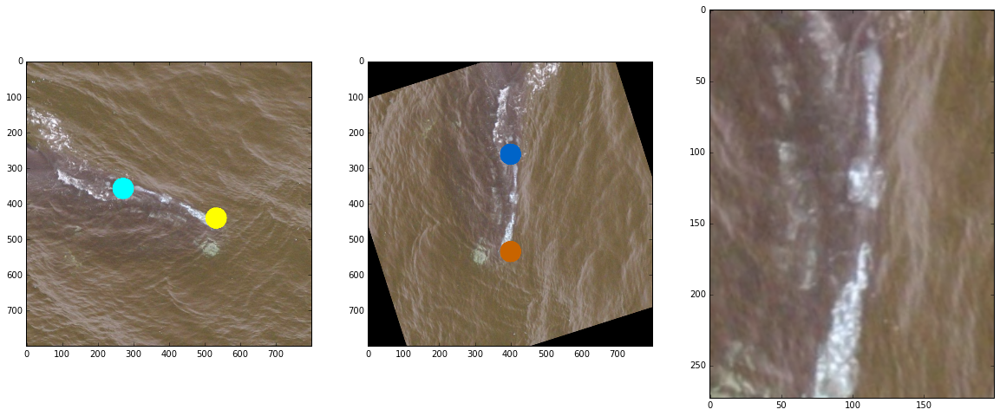

In [101]:
pad = 100
radius = 30
for i in range(50):
    row = df.ix[i+1]
    im = cv2.imread(row.path)
    h,w, c = im.shape
    x1, y1, x2, y2 = map(int,[row.x1*w, row.y1*h, row.x2*w, row.y2*h])
    imO = im.copy()
    cv2.circle(imO,(x1,y1),radius,(255,255,0),-1)
    cv2.circle(imO,(x2,y2),radius,(0,255,255),-1)
    plt.figure(figsize=(20,15))
    plt.subplot(131)
    plt.imshow(imO)
    front = np.array([x1,y1])
    back = np.array([x2,y2])
    direction = front - back
    mid = (front + back)/2
    
    angle = np.degrees(np.arctan2(direction[0],direction[1]))
    M = cv2.getRotationMatrix2D((mid[0],mid[1]),-angle,1)
    front = np.concatenate((front,np.array([1])))
    back = np.concatenate((back,np.array([1])))
    newFront = np.dot(M,front).astype(np.uint32)
    newBack = np.dot(M,back).astype(np.uint32)
    
    imDst = cv2.warpAffine(im, M,(w,h),borderValue=0)
    imDst2 = imDst.copy()
    cv2.circle(imDst,(int(newFront[0]),int(newFront[1])),radius,(200,100,0),-1)
    cv2.circle(imDst,(int(newBack[0]),int(newBack[1])),radius,(0,100,200),-1)
    plt.subplot(132)
    plt.imshow(imDst)
    plt.subplot(133)
    x,yMin = newFront
    x,yMax = newBack
    imDst2 = imDst2[yMax:yMin,x-pad:x+pad]
    plt.imshow(imDst2)
    plt.show()